<a href="https://colab.research.google.com/github/data-science-and-machine-learning/self-driving-car/blob/master/Self_driving_car.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Credits

In [0]:
# Credits: https://github.com/SullyChen/Autopilot-TensorFlow
# Research paper: End to End Learning for Self-Driving Cars by Nvidia. [https://arxiv.org/pdf/1604.07316.pdf]

# NVidia dataset: 72 hrs of video => 72*60*60*30 = 7,776,000 images
# Nvidia blog: https://devblogs.nvidia.com/deep-learning-self-driving-cars/


# Our Dataset: https://github.com/SullyChen/Autopilot-TensorFlow [https://drive.google.com/file/d/0B-KJCaaF7elleG1RbzVPZWV4Tlk/view]
# Size: 25 minutes = 25*60*30 = 45,000 images ~ 2.3 GB


# If you want to try on a slightly large dataset: 70 minutes of data ~ 223GB
# Refer: https://medium.com/udacity/open-sourcing-223gb-of-mountain-view-driving-data-f6b5593fbfa5
# Format: Image, latitude, longitude, gear, brake, throttle, steering angles and speed



# Additional Installations:
# pip3 install h5py


# AWS: https://aws.amazon.com/blogs/machine-learning/get-started-with-deep-learning-using-the-aws-deep-learning-ami/

# Youtube:https://www.youtube.com/watch?v=qhUvQiKec2U
# Further reading and extensions: https://medium.com/udacity/teaching-a-machine-to-steer-a-car-d73217f2492c
# More data: https://medium.com/udacity/open-sourcing-223gb-of-mountain-view-driving-data-f6b5593fbfa5

### Start

In [1]:
from google.colab import drive
drive.mount('/content/drive')


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
!unzip /content/drive/My\ Drive/driving_dataset.zip -d driving_dataset

#### Train code

In [3]:
#!kill -9 -1
!nvidia-smi

Fri Sep 20 14:13:38 2019       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 430.40       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P8    27W / 149W |      0MiB / 11441MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [5]:
import sys
sys.path.append("/content/drive/My Drive/Autopilot-TensorFlow/Files")
import driving_data
print(driving_data.num_images)

45406
45406


In [3]:
import sys
sys.path.append("/content/drive/My Drive/Autopilot-TensorFlow/Files")
import newmodel as model
import driving_data
import os
import tensorflow as tf
from tensorflow.core.protobuf import saver_pb2
from datetime import datetime #import time
#import #import model
#%load_ext tensorboard 
#%tensorboard --logdir=./logs 


LOGDIR = './save'

sess = tf.InteractiveSession()

L2NormConst = 0.001

train_vars = tf.trainable_variables()

loss = tf.reduce_mean(tf.square(tf.subtract(model.y_, model.y))) + tf.add_n([tf.nn.l2_loss(v) for v in train_vars]) * L2NormConst
train_step = tf.train.AdamOptimizer(1e-5).minimize(loss)
sess.run(tf.global_variables_initializer())

# create a summary to monitor cost tensor
tf.summary.scalar("loss", loss)
# merge all summaries into a single op
merged_summary_op =  tf.summary.merge_all()

saver = tf.train.Saver(write_version = saver_pb2.SaverDef.V1)

# op to write logs to Tensorboard
logs_path = './logs'
summary_writer = tf.summary.FileWriter(logs_path, graph=tf.get_default_graph())

epochs = 200
batch_size = 500
#print("num_images=", num_images)
# train over the dataset about 30 times
start_time = datetime.now()
print('Start Time', start_time, driving_data.num_images/batch_size)

#print('PlaceholderX', tf.shape(x))

for epoch in range(epochs):
   
  for i in range(int(driving_data.num_images/batch_size)):
    print("\repoch, batch_size, i= ", epoch, batch_size, i, end= '')
    xs, ys = driving_data.LoadTrainBatch(batch_size)
    #print("batch loaded" , i, end= '')
    train_step.run(feed_dict={model.x: xs, model.y_: ys, model.keep_prob: 0.8})
    if i % 10 == 0:
      xs, ys = driving_data.LoadValBatch(batch_size)
      loss_value = loss.eval(feed_dict={model.x:xs, model.y_: ys, model.keep_prob: 1})
      end_time = datetime.now()
      print("Epoch: %d, Step: %d, Loss: %g, time taken: " % (epoch, epoch * batch_size + i, loss_value), end_time-start_time)
      start_time = datetime.now()
    # write logs at every iteration
    summary = merged_summary_op.eval(feed_dict={model.x:xs, model.y_: ys, model.keep_prob: 1})
    summary_writer.add_summary(summary, epoch * driving_data.num_images/batch_size + i)
    if i % batch_size == 0:
      if not os.path.exists(LOGDIR):
        os.makedirs(LOGDIR)
      #checkpoint_path = os.path.join(LOGDIR, "model.ckpt")
      #filename = saver.save(sess, checkpoint_path)
  checkpoint_path = os.path.join('drive/My Drive/Autopilot-TensorFlow/myModel', "model_loss{}.ckpt".format(loss_value) )
  filename = saver.save(sess, checkpoint_path)
print("Run the command line:\n" \
          "--> tensorboard --logdir=./logs " \
          "\nThen open http://0.0.0.0:6006/ into your web browser")




Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
45406
Start Time 2019-09-20 15:20:17.324854 90.812
epoch, batch_size, i=  0 500 0Epoch: 0, Step: 0, Loss: 6.5574, time taken:  0:00:08.091672
epoch, batch_size, i=  0 500 10Epoch: 0, Step: 10, Loss: 7.56112, time taken:  0:00:25.018212
epoch, batch_size, i=  0 500 20Epoch: 0, Step: 20, Loss: 6.27121, time taken:  0:00:22.957099
epoch, batch_size, i=  0 500 30Epoch: 0, Step: 30, Loss: 6.33857, time taken:  0:00:23.460326
epoch, batch_size, i=  0 500 40Epoch: 0, Step: 40, Loss: 6.25052, time taken:  0:00:23.640041
epoch, batch_size, i=  0 500 50Epoch: 0, Step: 50, Loss: 7.26658, time taken:  0:00:23.090922
epoch, batch_size, i=  0 500 60Epoch: 0, Step: 60, Loss: 6.14391, time taken:  0:00:23.125437
epoch, batch_size, i=  0 500 70Epoch: 0, Step: 70, Loss: 6.13897, time taken:  0:00:23.648048
epoch, batch_size, i=  0 500 80Epoch: 0, Step: 80, Loss: 6.14033, time taken:  0:00

In [6]:
%load_ext tensorboard 
%tensorboard --logdir=./logs 

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 14754), started 0:00:16 ago. (Use '!kill 14754' to kill it.)

#### Running code

45406


Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
Instructions for updating:
Use standard file APIs to check for files with this prefix.
INFO:tensorflow:Restoring parameters from drive/My Drive/Autopilot-TensorFlow/myModel/model_loss1.5568785667419434.ckpt
45406
36325
25.41160952400572
  36325  27.481143182141242
  36326  27.64603077889452
  36327  8.51559469677405
  36328  9.042520739352085
  36329  5.651883354216232
  36330  -2.3993028752265553
  36331  23.266376879298946
  36332  11.430774076048852
  36333  36.60767951715272
  36334  18.907438943456018
  36335  35.71995641563157
  36336  43.58062305591332
  36337  34.27138257569859
  36338  29.554863746237984
  36339  28.9053742278723
  36340  10.709205571372024
  36341  10.96898498626429
  36342  9.989488901733917
  36343  8.664019830080305
  36344  4.099699813442386
  36345  2.70681720156757
  36346  -6.072966224094811
  36347  4.28853149210479
  36348  3.342

<Figure size 360x360 with 0 Axes>

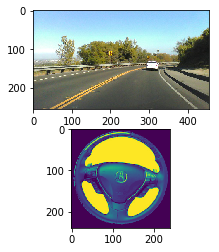

In [3]:
%matplotlib inline
import sys
sys.path.append("/content/drive/My Drive/Autopilot-TensorFlow/Files")
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import scipy.misc
import cv2
import math
import imageio
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import matplotlib
from matplotlib import rc
import numpy as np
from PIL import Image
from IPython.display import HTML
from matplotlib import animation, rc
from IPython.display import HTML
import driving_data
import newmodel as model

#x, y, y_, rate= create_model()
sess = tf.InteractiveSession()
#tf.reset_default_graph()
saver = tf.train.Saver(allow_empty=True)
saver.restore(sess, "drive/My Drive/Autopilot-TensorFlow/myModel/model_loss1.5568785667419434.ckpt")

xs = []
ys = []
img = cv2.imread('drive/My Drive/Autopilot-TensorFlow/Files/steering_wheel_image.jpg',0)
rows,cols = img.shape

with open("drive/My Drive/Autopilot-TensorFlow/Files/data.txt") as f:
  for line in f:
    xs.append("driving_dataset/driving_dataset" + line.split()[0])
    ys.append(float(line.split()[1]) * scipy.pi / 180)

#get number of images
driving_data.num_images = len(xs)
print(driving_data.num_images)
#fig, ax1 = plt.subplots()

i = math.ceil(driving_data.num_images*0.8)
print(i)
'''full_image= "driving_dataset/driving_dataset/" + str(i) + ".jpg"
image = np.array(Image.fromarray(imageio.imread(full_image)[-150:]).resize([200, 66]), dtype=float) / 255.0
print(np.shape(image))
plt.imshow(image)
while True:
  pass;'''
fig= plt.figure(figsize= (5,5))
fig, (ax1,ax2) = plt.subplots(2, 1)

smoothed_angle=0

def f(i):
  full_image= imageio.imread("driving_dataset/driving_dataset/" + str(i) + ".jpg")
  #image = np.array(Image.fromarray(imageio.imread(full_image[-150:], [66, 200]).resize()), dtype= float) / 255.0
  return full_image

def g(i):
  global smoothed_angle
  full_image= "driving_dataset/driving_dataset/" + str(i) + ".jpg"
  image = np.array(Image.fromarray(imageio.imread(full_image)[-150:]).resize([200, 66]), dtype=float) / 255.0
  degrees = model.y.eval(feed_dict={model.x: [image],
                                    model.keep_prob: 1}) [0][0] * 180.0 / scipy.pi
  print(degrees)

  smoothed_angle += 0.2 * pow(abs((degrees - smoothed_angle)), 2.0 / 3.0) * (degrees - smoothed_angle) / abs(degrees - smoothed_angle)

  M = cv2.getRotationMatrix2D((cols/2,rows/2),-smoothed_angle,1)
  dst = cv2.warpAffine(img,M,(cols,rows))
  return dst

im = ax1.imshow(f(i), animated=True)
im2= ax2.imshow(g(i), animated=True)
def updatefig(*args):
    global i
    print("\r  {}  ".format(i), end="")
    i+=1
    im.set_array(f(i))
    im2.set_array(g(i))
    return im, im2

anim = animation.FuncAnimation(fig, updatefig, frames= 250, interval=100, blit=True)
# Note: below is the part which makes it work on Colab
matplotlib.rcParams['animation.embed_limit'] = 2**128
rc('animation', html='jshtml')
anim
#plt.show()


### Steps :




Changed final output layer's activation function from atan to tanh and finally linear

After lowering the learning rate and trainining for 200 epochs, the final validation loss is 1.556

The model despite of not so good validation loss is not biased towards straight roads and turning as roads turns

The model can be further improved by playing around with dropouts, batch normalization layer and learning rates

In [0]:
ww